In [1]:
import matplotlib.pyplot as plt
import numpy as np

In [2]:
from model import *
from data import *
from analysis import *

In [3]:
oiii = for_oiii()
oiii_ = oiii[oiii["loglbol"] > 46]
oiii_res = np.loadtxt("../output/oiii.res")

cond_oiii = (oiii_res[:,3] > -0.5) & (oiii_res[:,-2] < 50)
oiii_ = oiii_[cond_oiii]
oiii_res = oiii_res[cond_oiii]

# oiii_ans = np.array([analysis(i) for i in oiii_res]) # default: 1-10um

initial: 105783
select redshift: 19083
select wise: 15666


(array([1.000e+00, 1.400e+01, 6.720e+02, 4.137e+03, 5.086e+03, 3.934e+03,
        1.416e+03, 3.410e+02, 5.500e+01, 1.000e+01]),
 array([44.11554512, 44.43090294, 44.74626077, 45.0616186 , 45.37697642,
        45.69233425, 46.00769207, 46.3230499 , 46.63840773, 46.95376555,
        47.26912338]),
 <BarContainer object of 10 artists>)

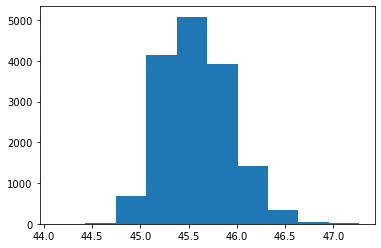

In [4]:
plt.hist(oiii["loglbol"])

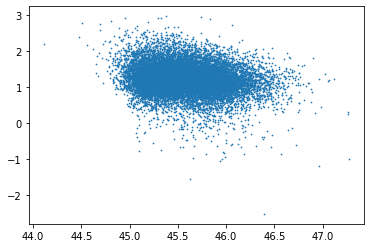

In [11]:
plt.scatter(oiii["loglbol"], np.log10(oiii["ew_oiii_5007"]), s=0.5)

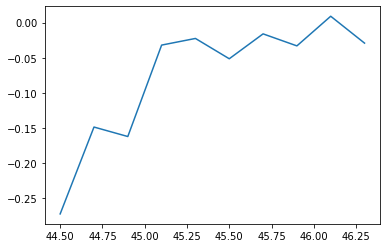

In [22]:
start, stop, step = 44.5, 46.5, 0.2
grids = np.arange(start, stop, step)
conds = [(oiii["loglbol"] > grid) & (oiii["loglbol"] < grid + step) for grid in grids]
cor = [np.corrcoef(oiii[cond]["loglbol"], np.log10(oiii[cond]["ew_oiii_5007"]))[0,1] for cond in conds]

plt.plot(grids, cor)

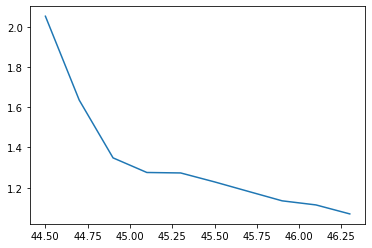

In [23]:
means = [np.mean(np.log10(oiii[cond]["ew_oiii_5007"])) for cond in conds]

plt.plot(grids, means)

In [6]:
np.std(oiii["loglbol"]), np.mean(oiii["loglbol"])

(0.3484347217256233, 45.584207409021055)

In [12]:
(lambda cond: np.corrcoef([oiii[cond]["loglbol"], np.log10(oiii[cond]["ew_oiii_5007"])]))(oiii["loglbol"] < 45)

array([[ 1.       , -0.3245381],
       [-0.3245381,  1.       ]])

In [7]:
np.corrcoef([oiii["loglbol"], np.log10(oiii["ew_oiii_5007"])])

array([[ 1.        , -0.18339599],
       [-0.18339599,  1.        ]])

In [8]:
np.corrcoef([oiii_["loglbol"], np.log10(oiii_["ew_oiii_5007"])])

array([[ 1.        , -0.06599454],
       [-0.06599454,  1.        ]])

In [10]:
def analysis_(params_, up): # 1-up um
    optic, nir = components(params_)

    loglbol = np.log10(5 * optic(0.3))
    loglnirs = np.log10(nir(np.linspace(1,up)))
    logcfs = loglnirs - loglbol

    return logcfs

In [11]:
oiii_ans_ = np.array([analysis_(i, 12) for i in oiii_res])
oiii_loglbol = np.log10(5) + disk_powlaw_(np.log10(0.3)) + oiii_res[:,0] # disk_amp
oiii_cors = [parcor([np.log10(oiii_["ew_oiii_5007"]), oiii_ans_[:,i], oiii_loglbol, oiii_["logbh_hb_vp06"]])[0,1]
for i in range(len(oiii_ans_[0,:]))]

In [13]:
np.savetxt("corr", oiii_cors)

In [4]:
from astropy.table import Table
from scipy.interpolate import interp1d

In [5]:
result = Table.read("/Users/wul/Desktop/out/results.fits")

In [19]:
oiii_ans_x = []
for i in range(len(oiii_)):
    s = oiii_[i]
    zp1 = s["z_hw"] + 1
    tb = Table.read(f"/Users/wul/Desktop/out/{s['sdss_name']}_best_model.fits")
    wavelength = tb["wavelength"] * 1e-3 / zp1
    dust = tb["agn.SKIRTOR2016_dust"] * zp1
    func = interp1d(wavelength, dust, kind='cubic')
    oiii_ans_x.append(func(np.linspace(1, 12)) / result[i]['best.agn.luminosity'])

oiii_ans_x = np.array(oiii_ans_x)

In [24]:
oiii_cors_x = [parcor([np.log10(oiii_["ew_oiii_5007"]), np.log10(oiii_ans_x[:,i]), result['best.agn.luminosity'], oiii_["logbh_hb_vp06"]])[0,1]
for i in range(len(oiii_ans_x[0,:]))]

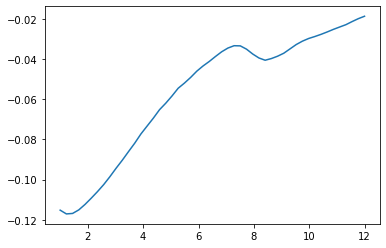

In [25]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors_x)

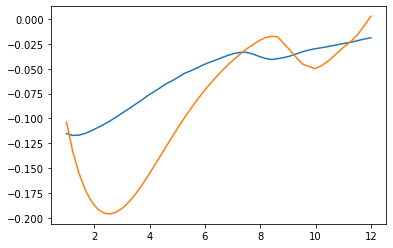

In [26]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors_x)
plt.plot(x, oiii_cors)

In [27]:
np.savetxt("corr_x__", oiii_cors_x)

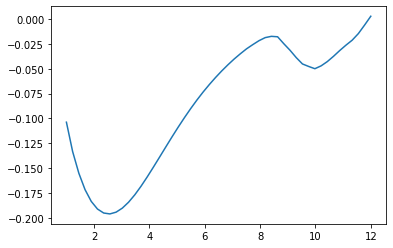

In [7]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors)

In [165]:
oiii_res_sd = np.loadtxt("../output/oiii_single_dust.res")[cond_oiii]

In [166]:
oiii_ans_ = np.array([analysis_(i, 12) for i in oiii_res_sd])
oiii_loglbol = np.log10(5) + disk_powlaw_(np.log10(0.3)) + oiii_res[:,0] # disk_amp
oiii_cors = [parcor([np.log10(oiii_["ew_oiii_5007"]), oiii_ans_[:,i], oiii_loglbol, oiii_["logbh_hb_vp06"]])[0,1]
for i in range(len(oiii_ans_[0,:]))]

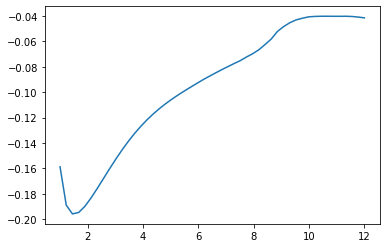

In [167]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors)

In [28]:
def single_bootstrap():
    ind = np.random.choice(np.arange(len(oiii_)), len(oiii_))
    logew = np.log10(oiii_["ew_oiii_5007"])[ind]
    oiii_ind = oiii_[ind]
    oiii_ans_ind = oiii_ans_[ind]
    oiii_loglbol_ind = oiii_loglbol[ind]

    return [parcor([logew, oiii_ans_ind[:,i], oiii_loglbol_ind, oiii_ind["logbh_hb_vp06"]])[0,1]
        for i in range(len(oiii_ans_ind[0,:]))]

In [40]:
oiii_cors_std = np.std([single_bootstrap() for _ in range(1000)], axis=0)

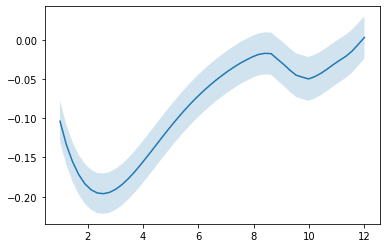

In [44]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors)
plt.fill_between(x, oiii_cors + oiii_cors_std, oiii_cors - oiii_cors_std, alpha=0.2)

In [60]:
corss = []
for n in ['0', '-0.05', '-0.1', '-0.15', '-0.2']:
    res = []
    sims = []
    for i in range(100):
        sims.append(np.loadtxt(f"../temp/{n}/oiii{i}.sim"))
    for sim in sims:
        sim_ans = np.array([analysis_(i, 12) for i in sim[:,:-1]])
        sim_logew = sim[:,-1]
        sim_loglbol = np.log10(5) + disk_powlaw_(np.log10(0.3)) + sim[:,0]
        sim_cors = [parcor([sim_logew, sim_ans[:,i], sim_loglbol, oiii_["logbh_hb_vp06"]])[0,1]
                    for i in range(len(oiii_ans_[0,:]))]
        res.append(sim_cors)
    corss.append(res)

corss = np.array(corss)

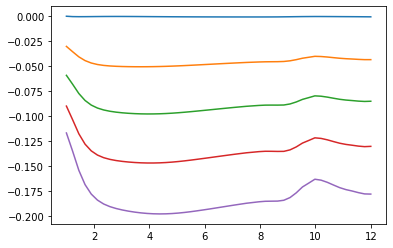

In [63]:
x = np.linspace(1,12)
plt.plot(x, np.mean(corss[0], axis=0))
plt.plot(x, np.mean(corss[1], axis=0))
plt.plot(x, np.mean(corss[2], axis=0))
plt.plot(x, np.mean(corss[3], axis=0))
plt.plot(x, np.mean(corss[4], axis=0))

(array([  9.,   9.,  20.,  83., 316., 618., 319.,  78.,   6.,   1.]),
 array([-0.85951336, -0.50031551, -0.14111766,  0.21808019,  0.57727805,
         0.9364759 ,  1.29567375,  1.65487161,  2.01406946,  2.37326731,
         2.73246517]),
 <a list of 10 Patch objects>)

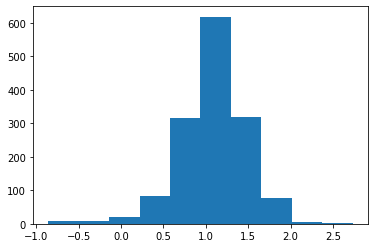

In [64]:
plt.hist(np.log10(oiii_["ew_oiii_5007"]))

In [67]:
sample0 = oiii_res[:,-1] == 0
sample1 = oiii_res[:,-1] == 1
sample2 = oiii_res[:,-1] == 2

(array([  4.,   7.,  15.,  59., 227., 484., 259.,  65.,   4.,   1.]),
 array([-0.85951336, -0.50031551, -0.14111766,  0.21808019,  0.57727805,
         0.9364759 ,  1.29567375,  1.65487161,  2.01406946,  2.37326731,
         2.73246517]),
 <a list of 10 Patch objects>)

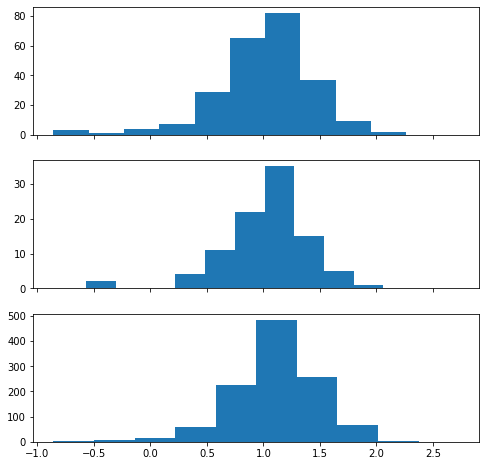

In [79]:
fig, axs = plt.subplots(3,1, figsize=(8,8), sharex=True)
axs[0].hist(np.log10(oiii_[sample0]["ew_oiii_5007"]))
axs[1].hist(np.log10(oiii_[sample1]["ew_oiii_5007"]))
axs[2].hist(np.log10(oiii_[sample2]["ew_oiii_5007"]))

In [80]:
[np.mean(np.log10(oiii_[s]["ew_oiii_5007"])) for s in [sample0, sample1, sample2]]

[1.0076719667964318, 1.0308830037517127, 1.1047304441136185]

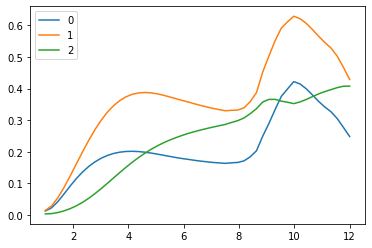

In [83]:
for i, dust_model in enumerate(dust_models):
    plt.plot(x, dust_model(x), label=i)
plt.legend()

In [84]:
from prepare_data import prepare_data

<ErrorbarContainer object of 3 artists>

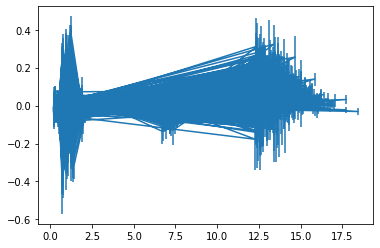

In [85]:
x = []
y = []
yerr = []

for data, params_ in zip(oiii_, oiii_res):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]

    bands = np.log10([get_band(dust_model, params)(rsr, wav) for rsr, wav in zip(rsr, wavelength)])

    x.extend(wavelength)
    y.extend(lum - bands)
    yerr.extend(lum_unc)

<ErrorbarContainer object of 3 artists>

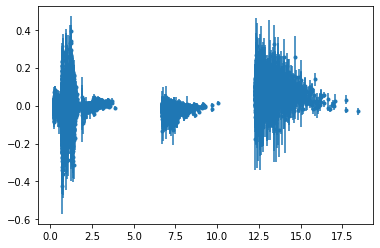

In [87]:
plt.errorbar(x, y, yerr=yerr, fmt='.')

<ErrorbarContainer object of 3 artists>

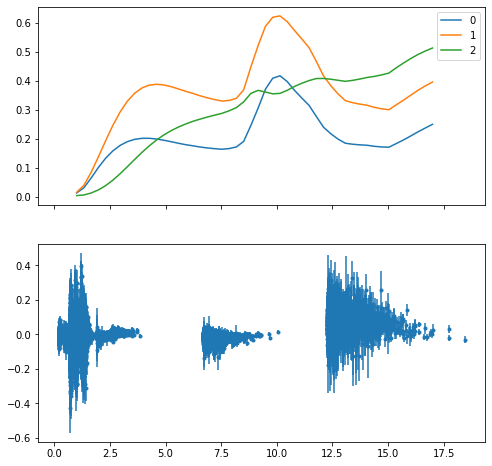

In [90]:
fig, axs = plt.subplots(2,1, figsize=(8,8), sharex=True)

for i, dust_model in enumerate(dust_models):
    axs[0].plot(np.linspace(1,17), dust_model(np.linspace(1,17)), label=i)
axs[0].legend()

axs[1].errorbar(x, y, yerr=yerr, fmt='.')

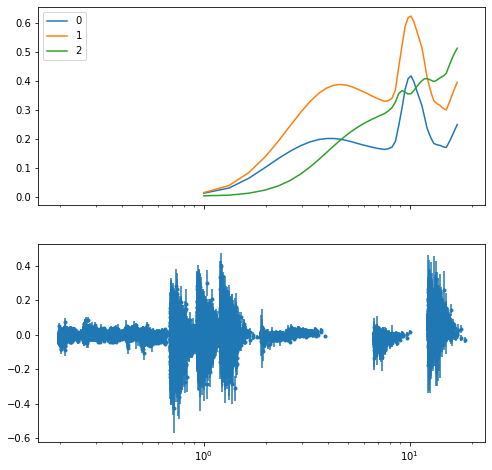

In [91]:
fig, axs = plt.subplots(2,1, figsize=(8,8), sharex=True)

for i, dust_model in enumerate(dust_models):
    axs[0].plot(np.linspace(1,17), dust_model(np.linspace(1,17)), label=i)
axs[0].legend()

axs[1].errorbar(x, y, yerr=yerr, fmt='.')

plt.xscale('log')

In [97]:
ew_high = np.log10(oiii_["ew_oiii_5007"]) > 1.5
ew_low = np.log10(oiii_["ew_oiii_5007"]) < 0.5

x_ind = np.linspace(1,17)
seds_low = []
for data, params_ in zip(oiii_[ew_low], oiii_res[ew_low]):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]

    sed = get_sed(dust_model, params)
    seds_low.append(sed(x_ind) / 10 ** params[0])


seds_high = []
for data, params_ in zip(oiii_[ew_high], oiii_res[ew_high]):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]

    sed = get_sed(dust_model, params)
    seds_high.append(sed(x_ind) / 10 ** params[0])

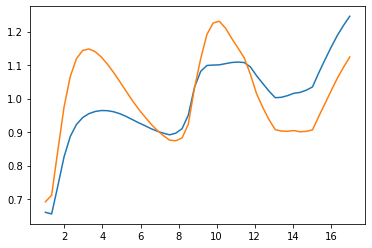

In [98]:
plt.plot(x_ind, np.mean(seds_high, axis=0))
plt.plot(x_ind, np.mean(seds_low, axis=0))

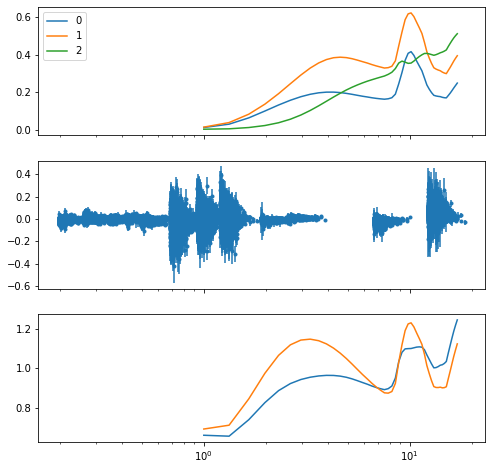

In [99]:
fig, axs = plt.subplots(3, 1, figsize=(8,8), sharex=True)

for i, dust_model in enumerate(dust_models):
    axs[0].plot(np.linspace(1,17), dust_model(np.linspace(1,17)), label=i)
axs[0].legend()

axs[1].errorbar(x, y, yerr=yerr, fmt='.')

axs[2].plot(x_ind, np.mean(seds_high, axis=0))
axs[2].plot(x_ind, np.mean(seds_low, axis=0))

plt.xscale('log')

(array([  3.,   5.,  13.,  23.,  55., 108., 170., 216., 352., 514.]),
 array([0.192899 , 0.2532983, 0.3136976, 0.3740969, 0.4344962, 0.4948955,
        0.5552948, 0.6156941, 0.6760934, 0.7364927, 0.796892 ]),
 <a list of 10 Patch objects>)

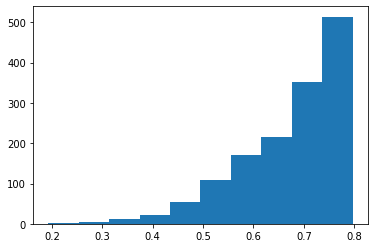

In [105]:
plt.hist(oiii_["z_hw"])

In [106]:
z_high = oiii_["z_hw"] > 0.75
z_low = oiii_["z_hw"] < 0.5

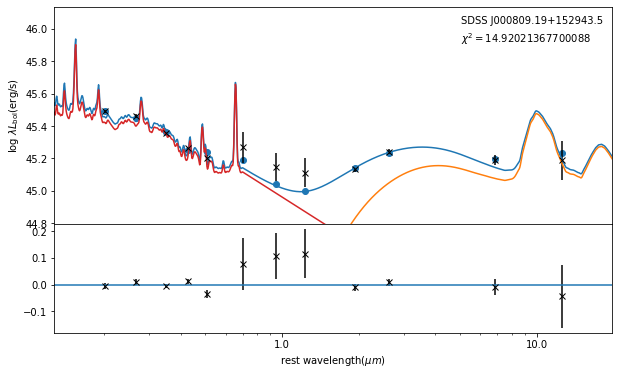

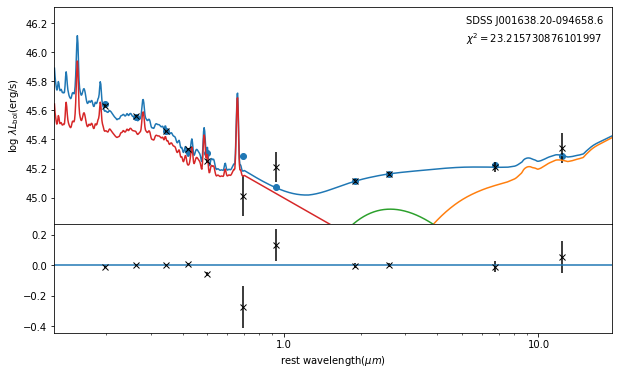

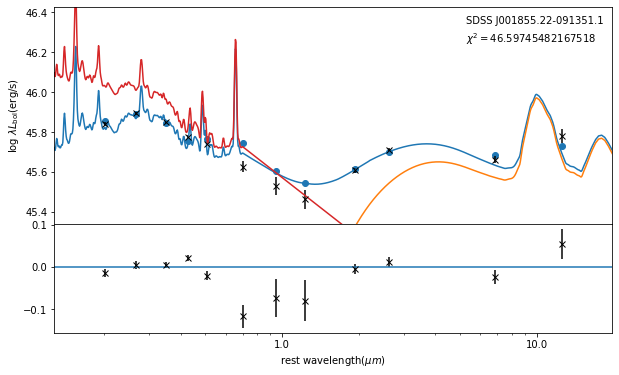

In [115]:
for i in range(3):
    show_for_paper(oiii_[z_high][i], oiii_res[z_high][i])

In [116]:
from scipy.interpolate import CubicSpline

In [142]:
def fit_spine(data, params_):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]
    bands = np.log10([get_band(get_sed(dust_model, params))(rsr, wav) for rsr, wav in zip(rsr, wavelength)])

    return CubicSpline(wavelength, lum - bands, bc_type='clamped')

In [152]:
def fit_spine_no_clamped(data, params_):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]
    bands = np.log10([get_band(get_sed(dust_model, params))(rsr, wav) for rsr, wav in zip(rsr, wavelength)])

    return CubicSpline(wavelength, lum - bands)

In [139]:
def get_band(sed):

    @np.vectorize
    def band(rsr, wavelength):
        return wavelength*integrate.trapz(rsr.ys*sed(rsr.xs)/rsr.xs, x=rsr.xs)

    return band

In [134]:
from model import *

In [144]:
def show_with_spine(data, params_):
    rsr, wavelength, lum, lum_unc = prepare_data(data)
    *params, residual, mod = params_
    dust_model = dust_models[int(mod)]

    spine = fit_spine(data, params_)
    sed = get_sed(dust_model, params)
    sed_with_spine = lambda x: sed(x) * 10**spine(x)

    x = np.logspace(np.log10(np.min(wavelength))-0.2, np.log10(np.max(wavelength))+0.2, 1000)

    fig = plt.figure(constrained_layout=True, figsize=(10,8))
    ax0 = plt.subplot2grid((4, 1), (0, 0), rowspan=2)
    ax1 = plt.subplot2grid((4, 1), (2, 0), sharex=ax0)
    ax2 = plt.subplot2grid((4, 1), (3, 0), sharex=ax0)

    plt.subplots_adjust(hspace=0)

    ax0.plot(x, np.log10(sed(x)))
    ax0.plot(x, np.log10(dust_model(x)) + params[4])
    ax0.plot(x, np.log10(blackbody(x, params[1], 10**params[2])))
    ax0.plot(x, np.log10(disk_powlaw(x, 10**params[0])))

    ax0.plot(x, np.log10(sed_with_spine(x)))

    ax0.errorbar(wavelength, lum, yerr=lum_unc, fmt="kx")
    bands = np.log10([get_band(sed)(rsr, wav) for rsr, wav in zip(rsr, wavelength)])
    bands_with_spine = np.log10([get_band(sed_with_spine)(rsr, wav) for rsr, wav in zip(rsr, wavelength)])
    ax0.scatter(wavelength, bands)

    ax0.set_ylabel(r"log $\lambda L_{\mathrm{bol}}$(erg/s)")

    ax0.set_xscale("log")
    ax0.set_ylim((np.log10(sed(x).min()) - 0.2, np.log10(sed(x).max()) + 0.2))
    ax0.set_xlim(x.min(), x.max())

    ax0.plot([], [], ' ', label=f"SDSS J{data['sdss_name']}")
    ax0.plot([], [], ' ', label=f"$\\chi^2={residual}$")
    ax0.legend().get_frame().set_linewidth(0.0)

    ax1.errorbar(wavelength, lum - bands, yerr=lum_unc, fmt="kx")
    ax1.plot(x, np.zeros_like(x))
    ax1.plot(x, spine(x), c='tab:purple')

    ax2.errorbar(wavelength, lum - bands_with_spine, yerr=lum_unc, fmt="kx")
    ax2.plot(x, np.zeros_like(x), c='tab:purple')

    ax1.xaxis.set_major_formatter(ScalarFormatter())
    
    
    ax2.set_xlabel(r"rest wavelength($\mu m$)")

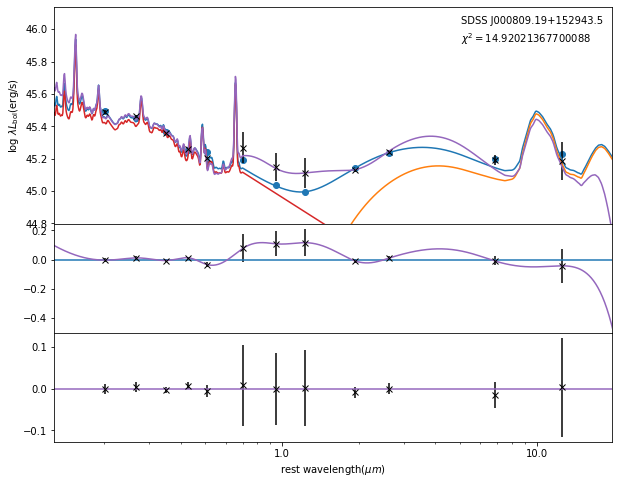

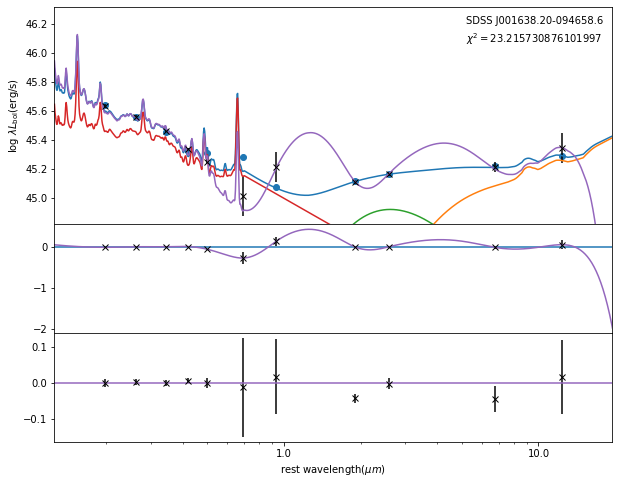

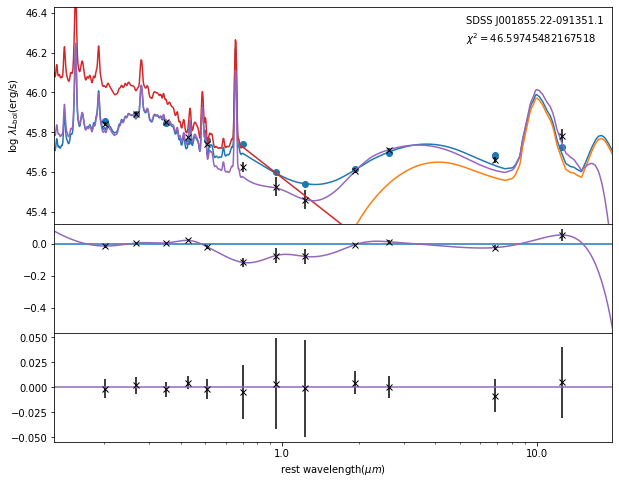

In [147]:
for i in range(3):
    show_with_spine(oiii_[z_high][i], oiii_res[z_high][i])

In [155]:
def analysis_spine(data, params_, up): # 1-up um
    optic, nir = components(params_)

    spine = fit_spine(data, params_)

    loglbol = np.log10(5 * optic(0.3))
    loglnirs = np.log10(nir(np.linspace(1,up))) + spine(np.linspace(1,up))
    logcfs = loglnirs - loglbol

    return logcfs

In [153]:
def analysis_spine_(data, params_, up): # 1-up um
    optic, nir = components(params_)

    spine = fit_spine_no_clamped(data, params_)

    loglbol = np.log10(5 * optic(0.3))
    loglnirs = np.log10(nir(np.linspace(1,up))) + spine(np.linspace(1,up))
    logcfs = loglnirs - loglbol

    return logcfs

In [156]:
oiii_ans_ = np.array([analysis_spine(i, j, 12) for i, j in zip(oiii_, oiii_res)])
oiii_loglbol = np.log10(5) + disk_powlaw_(np.log10(0.3)) + oiii_res[:,0] # disk_amp
oiii_cors = [parcor([np.log10(oiii_["ew_oiii_5007"]), oiii_ans_[:,i], oiii_loglbol, oiii_["logbh_hb_vp06"]])[0,1]
for i in range(len(oiii_ans_[0,:]))]

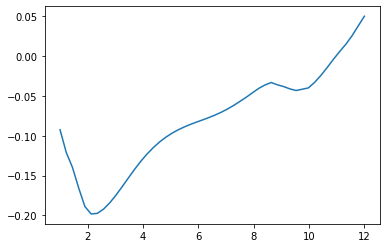

In [157]:
x = np.linspace(1,12)
plt.plot(x, oiii_cors)

In [158]:
oiii_ans_ = np.array([analysis_spine_(i, j, 12) for i, j in zip(oiii_, oiii_res)])
oiii_loglbol = np.log10(5) + disk_powlaw_(np.log10(0.3)) + oiii_res[:,0] # disk_amp
oiii_cors = [parcor([np.log10(oiii_["ew_oiii_5007"]), oiii_ans_[:,i], oiii_loglbol, oiii_["logbh_hb_vp06"]])[0,1]
for i in range(len(oiii_ans_[0,:]))]

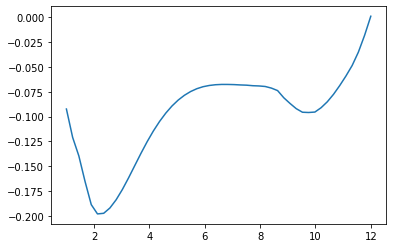

In [159]:
x = np.linspace(1,12) # 没有边界条件
plt.plot(x, oiii_cors)

(array([ 24., 170., 390., 368., 247., 136.,  74.,  34.,  14.,   2.]),
 array([45.7815798 , 45.89466895, 46.00775809, 46.12084724, 46.23393638,
        46.34702552, 46.46011467, 46.57320381, 46.68629296, 46.7993821 ,
        46.91247125]),
 <a list of 10 Patch objects>)

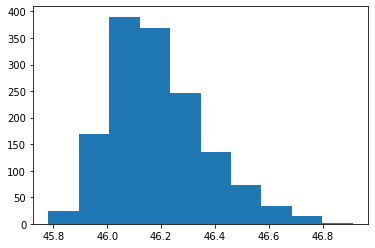

In [160]:
plt.hist(oiii_loglbol)

In [161]:
np.mean(oiii_loglbol)

46.188857051039264

In [170]:
oiii_loglbol = m_coef * np.concatenate((oiii_["ugriz"], np.zeros((len(oiii_),1))), axis=1)

array([[18.53300095, 17.97299957, 17.81100082, 17.69499969, 17.59399986],
       [17.99900055, 17.67399979, 17.64599991, 17.48399925, 17.51199913],
       [18.88299942, 18.50900078, 18.4470005 , 18.47900009, 18.42700005],
       ...,
       [18.13899994, 17.77000046, 17.62199974, 17.55200005, 17.38299942],
       [18.74300003, 18.21199989, 18.10499954, 18.23200035, 18.06900024],
       [17.62000084, 17.30999947, 17.47100067, 17.35899925, 17.51199913]])

In [202]:
phot_data = np.transpose(np.concatenate((oiii_["ugriz"], np.transpose([np.log10(oiii_["z_hw"]+1)]), np.ones((len(oiii_),1))), axis=1))

In [203]:
phot_data

array([[18.53300095, 17.99900055, 18.88299942, ..., 18.13899994,
        18.74300003, 17.62000084],
       [17.97299957, 17.67399979, 18.50900078, ..., 17.77000046,
        18.21199989, 17.30999947],
       [17.81100082, 17.64599991, 18.4470005 , ..., 17.62199974,
        18.10499954, 17.47100067],
       ...,
       [17.59399986, 17.51199913, 18.42700005, ..., 17.38299942,
        18.06900024, 17.51199913],
       [ 0.23125392,  0.18433192,  0.23536859, ...,  0.24737932,
         0.2467233 ,  0.19346216],
       [ 1.        ,  1.        ,  1.        , ...,  1.        ,
         1.        ,  1.        ]])

In [204]:
m_coef = np.matmul(oiii_loglbol, np.linalg.pinv(phot_data))

In [205]:
m_coef

array([ 0.33128731, -0.08896447, -0.10361251, -0.40453117, -0.12361966,
        5.7303205 , 51.73411994])

In [197]:
oiii_loglbol_fit = np.matmul(m_coef, phot_data)

In [190]:
len(oiii_loglbol_fit)

1459

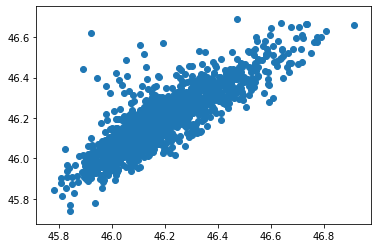

In [198]:
plt.scatter(oiii_loglbol, oiii_loglbol_fit)

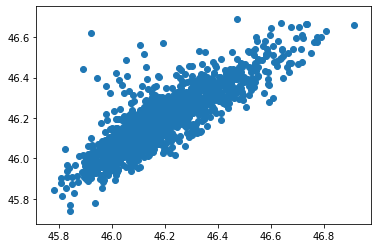

In [206]:
plt.scatter(oiii_loglbol, oiii_loglbol_fit)

In [207]:
len(oiii_)

1459